In [1]:
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import os
import tensorflow as tf
from skimage.transform import resize
import xml
import xml.etree.ElementTree as ET
import warnings
import math
from scipy import ndimage

2025-08-27 12:42:30.550856: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-08-27 12:42:31.584375: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-08-27 12:42:31.584453: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-08-27 12:42:31.707459: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-08-27 12:42:31.991540: I tensorflow/core/platform/cpu_feature_guar

In [2]:
# We may need to go through the entire framework again, but hopefully it will be worth it - let's get back to this in some time

In [3]:
# We need to prerpocess the train and validation data also I believe? - To match window size

In [4]:
# Locate the train and validation images and the xml files? - We also only  need the horizontal images for our task

# Train data locations
block_0101 = '../../../Spring_2024/S_lab_TasselNet/Block_1_TN/Block_1_images_and_xml'
block_0102 = '../../../Spring_2024/S_lab_TasselNet/Block_2_TN/Block_2_images_and_xml'
block_0203 = '../../../Spring_2024/S_lab_TasselNet/Block_9_TN/Block_9_images_and_xml'
block_0301 = '../../../Spring_2024/S_lab_TasselNet/Block_13_TN/Block_13_images_and_xml'

# train_blocks = [block_0101, block_0102, block_0203, block_0301]

# valid data location
block_0204 = '../../../Spring_2024/S_lab_TasselNet/Block_10_TN/Block_10_images_and_xml'

# valid_blocks = [block_0204]

In [5]:
block_0101_contents = os.listdir(block_0101)

In [6]:
block_0101_contents.sort()

In [7]:
# block_0101_contents

In [8]:
def chose_xml_and_jpeg(file_location):
    # list all files in location
    list_of_all_files = os.listdir(file_location)
    # sort files
    list_of_all_files.sort()
    # separate xml and jpeg files
    all_xml_files = [file for file in list_of_all_files if file.split('.')[-1] == 'xml']
    all_xml_files.sort()
    all_jpeg_files = [file for file in list_of_all_files if file not in all_xml_files]
    all_jpeg_files.sort()
    # get the final 20 files
    chosen_xml_files = all_xml_files[-20:]
    chosen_jpeg_files = all_jpeg_files[-20:]
    # make sure the xml and jpeg files correspond to each other?
    mean = np.mean([file.split('.')[0] for file in chosen_xml_files] == [file.split('.')[0] for file in chosen_jpeg_files])

    # chose the required files only - notice that for the inputs we do not need to create their density maps - therefore we do not need the xml files
    task_specific_image_files = chosen_jpeg_files[:13]
    return(task_specific_image_files, mean)

In [9]:
all_im_files_0101, mean_0101 =  chose_xml_and_jpeg(block_0101)

In [10]:
all_im_files_0101

['Block0101_2020_08_03.jpeg',
 'Block0101_2020_08_04.jpeg',
 'Block0101_2020_08_06.jpeg',
 'Block0101_2020_08_07.jpeg',
 'Block0101_2020_08_11.jpeg',
 'Block0101_2020_08_12.jpeg',
 'Block0101_2020_08_14.jpeg',
 'Block0101_2020_08_15.jpeg',
 'Block0101_2020_08_17.jpeg',
 'Block0101_2020_08_18.jpeg',
 'Block0101_2020_08_19.jpeg',
 'Block0101_2020_08_21.jpeg',
 'Block0101_2020_08_25.jpeg']

In [11]:
mean_0101

1.0

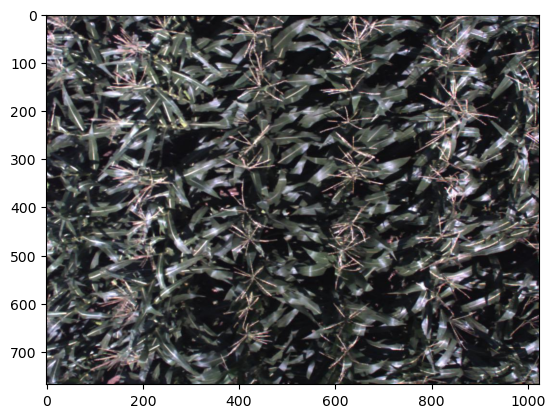

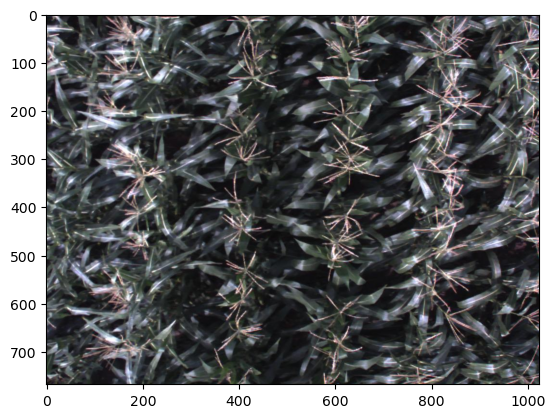

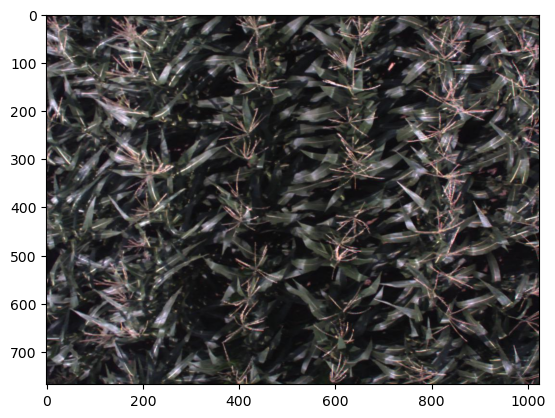

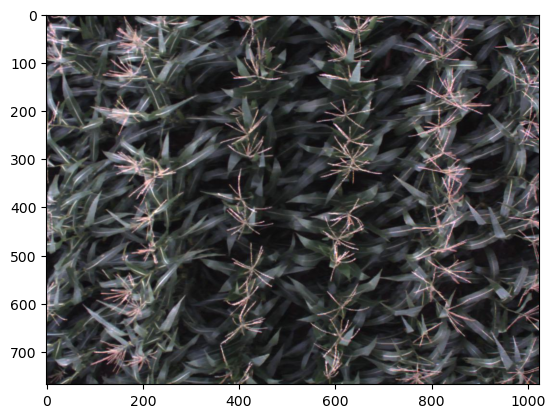

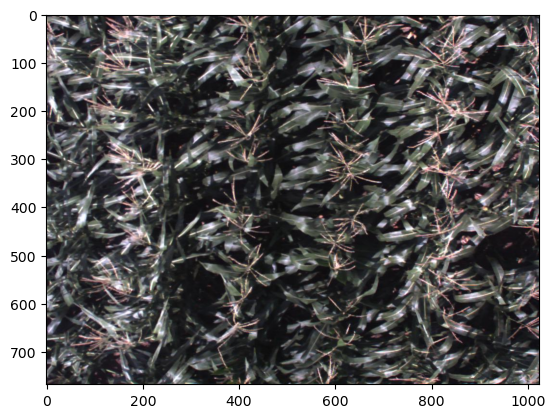

...

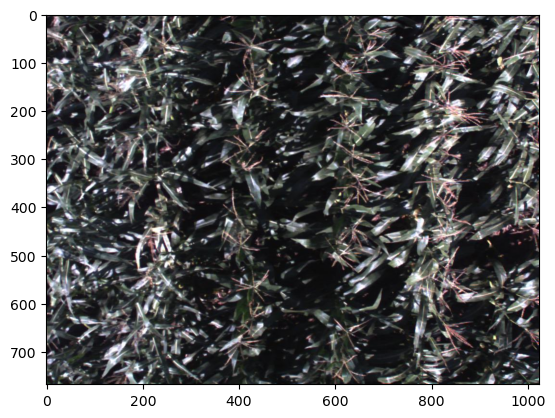

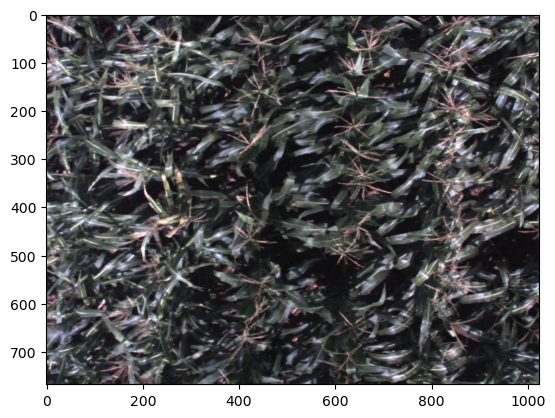

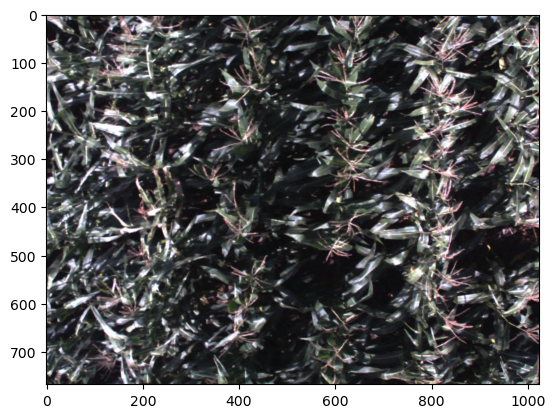

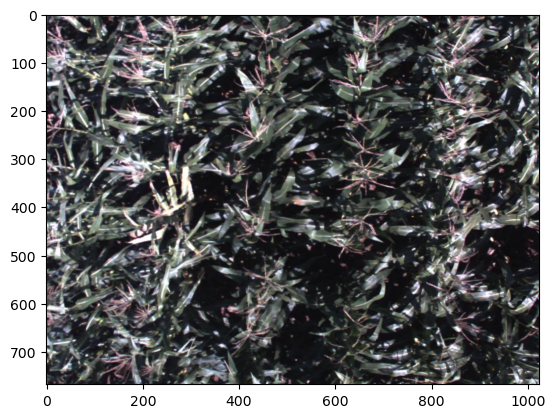

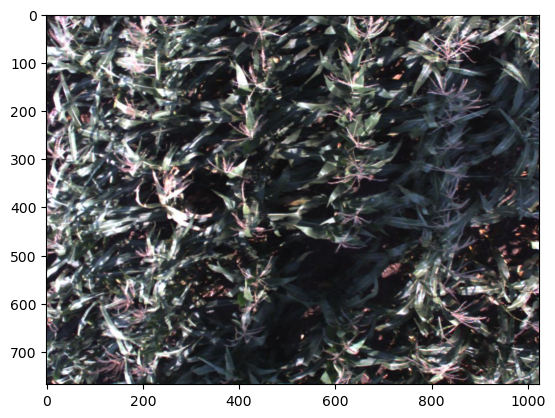

CPU times: user 2.82 s, sys: 59.3 ms, total: 2.88 s
Wall time: 3.43 s


In [12]:
# load the image data - we need images collected periodically - for each sub-image, the input features should have shape (13, 100, 100, 3)
all_images = []
for file in all_im_files_0101:
    joined_path = os.path.join(block_0101, file)
    read_image = plt.imread(joined_path)
    plt.imshow(read_image)
    plt.show()
    all_images.append(read_image)

In [13]:
# So we basically read the images in a loop?

In [14]:
len(all_images)

13

In [15]:
# cool whats the shape of a single read image?

In [16]:
all_images[0].shape

(768, 1024, 3)

In [17]:
# cool everything matches with what we already had - as it should!

In [18]:
# get shapes of all images printed?
for file in all_images:
    print(file.shape)

(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)


In [19]:
# write a function for reading the images

def read_all_images(file_names, im_path):
    all_images = []
    for file in file_names:
        joined_path = os.path.join(im_path, file)
        read_image = plt.imread(joined_path)
        plt.imshow(read_image)
        plt.show()
        all_images.append(read_image)

    return all_images

In [20]:
# make sure the function works - sanity check

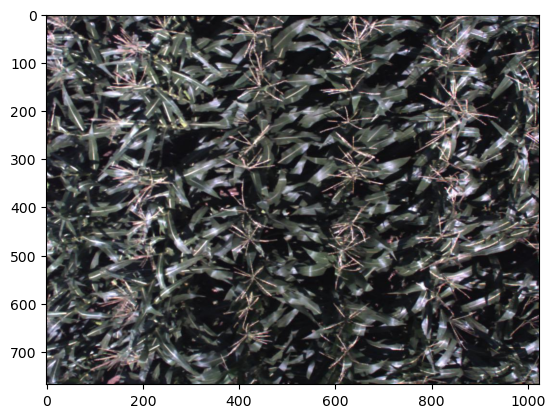

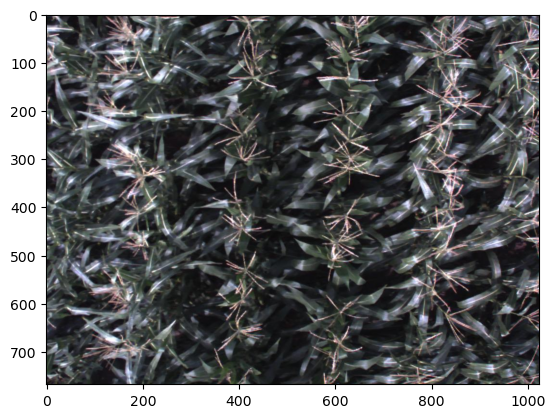

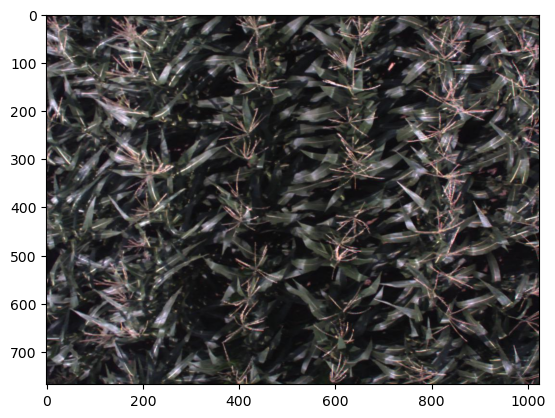

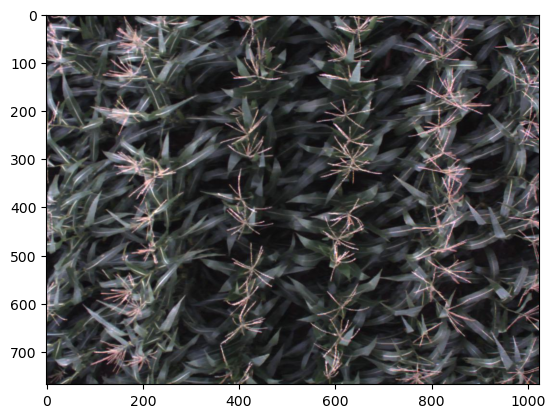

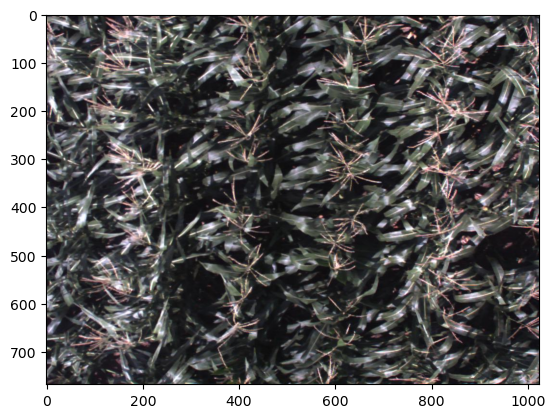

...

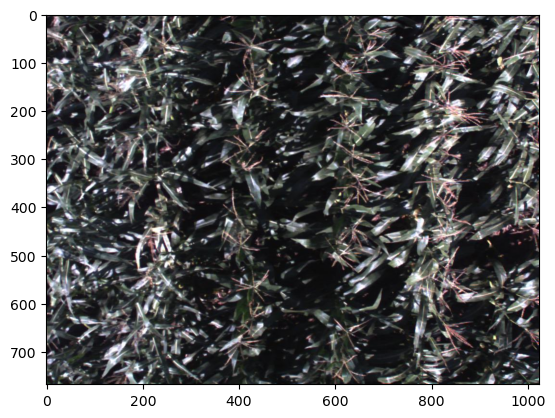

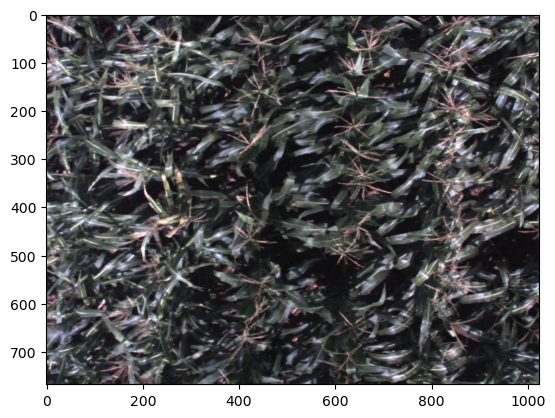

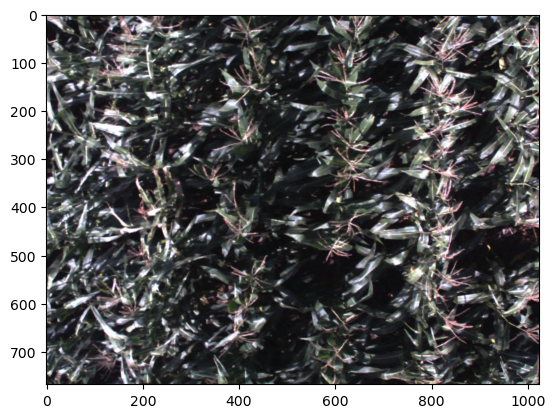

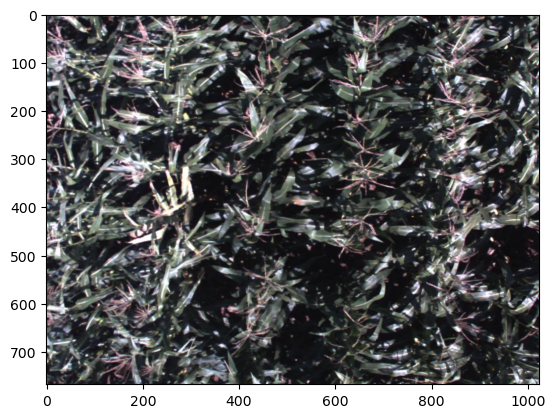

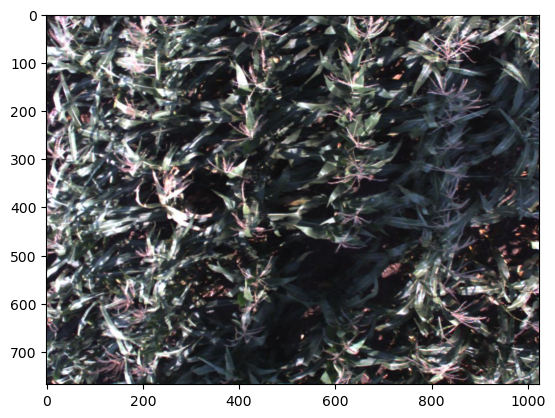

In [21]:
read_images = read_all_images(all_im_files_0101, block_0101)

In [22]:
for file in read_images:
    print(file.shape)

(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)


In [23]:
# Something to keep in mind here though, since we are foing to load all images in here, the file size is going to blow up. - so we might need to take away all cell outputs before we push this notebook to github

In [24]:
im_height = all_images[0].shape[0]
im_width = all_images[0].shape[1]
stride = 16
kernel_size = 100
n_channels = 3
catch_subwindows_all = []

for i in range(0, im_height, stride):
    for j in range(0, im_width, stride):
        will_this_work = []
        for im_file in all_images:
            chosen_window = im_file[i:i+kernel_size, j:j+kernel_size, :]
            # resize the window
            chosen_window = resize(chosen_window, (kernel_size, kernel_size ,n_channels))
            will_this_work.append(chosen_window)
        catch_subwindows_all.append(will_this_work)

CPU times: user 1min 4s, sys: 3.48 s, total: 1min 7s
Wall time: 1min 8s


In [25]:
len(catch_subwindows_all)

3072

In [26]:
len(catch_subwindows_all[0])

13

In [27]:
try_stack = np.stack(catch_subwindows_all)

CPU times: user 2.41 s, sys: 5.31 s, total: 7.72 s
Wall time: 7.75 s


In [28]:
try_stack.shape

(3072, 13, 100, 100, 3)

In [29]:
# This process is going to take so much time, should we maybe increase the stride size a little? Maybe to a 16 to keep things manageable?

In [30]:
# Do a function for this

def create_and_stack_subwindows(im_height, im_width, stride, kernel_size, n_channels, im_list):
    # initiate an empty list
    catch_all_subwindows = []
    for i in range(0, im_height, stride):
        for j in range(0, im_width, stride):
            local_list_at_subimage_sequence_level= []
            for im_file in im_list:
                chosen_window = im_file[i:i+kernel_size, j:j+kernel_size, :]
                # resize the window
                chosen_window = resize(chosen_window, (kernel_size, kernel_size ,n_channels))
                local_list_at_subimage_sequence_level.append(chosen_window)
            catch_all_subwindows.append(local_list_at_subimage_sequence_level)
    # stack all these together
    Stacked_subwindows = np.stack(catch_all_subwindows)
    return(Stacked_subwindows)

In [ ]:
im_height = all_images[0].shape[0]
im_width = all_images[0].shape[1]
stride = 16
kernel_size = 100
n_channels = 3
stack_block_0101 = create_and_stack_subwindows(im_height, im_width, stride, kernel_size, n_channels, all_images)

In [32]:
# Block 0102

In [33]:
# get all image files
all_im_files_0102, mean_0102 =  chose_xml_and_jpeg(block_0102)

In [36]:
# all_im_files_0102

In [38]:
# mean_0102

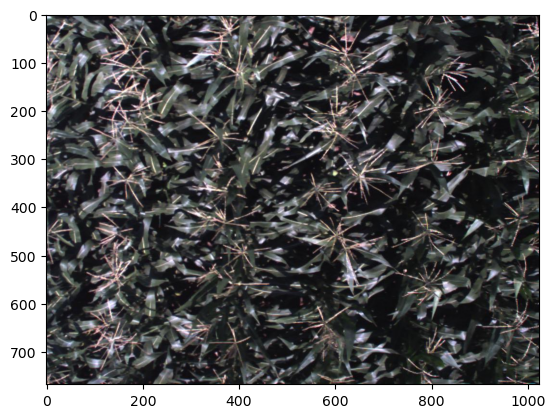

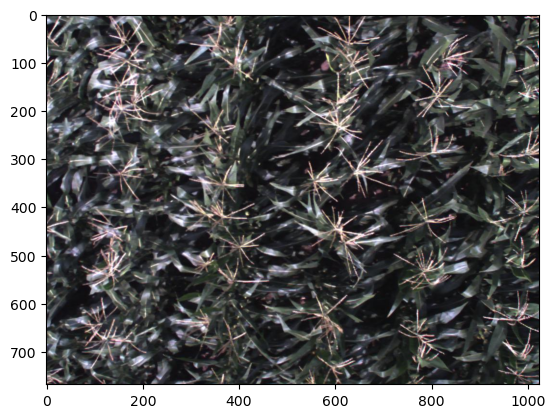

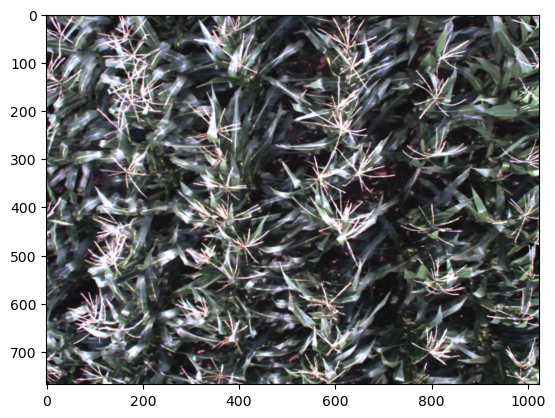

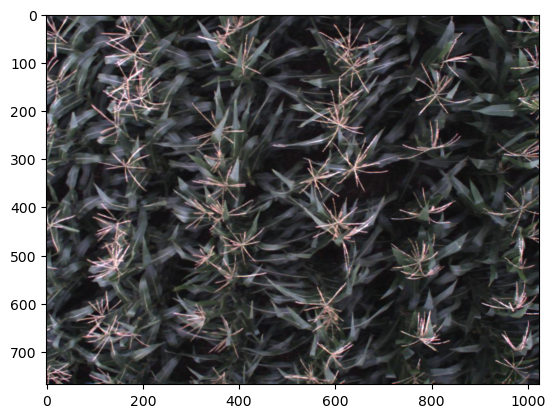

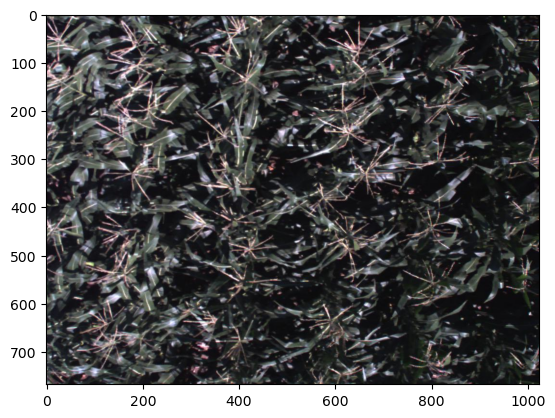

...

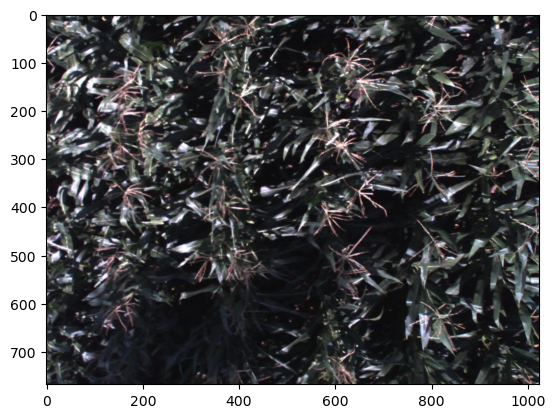

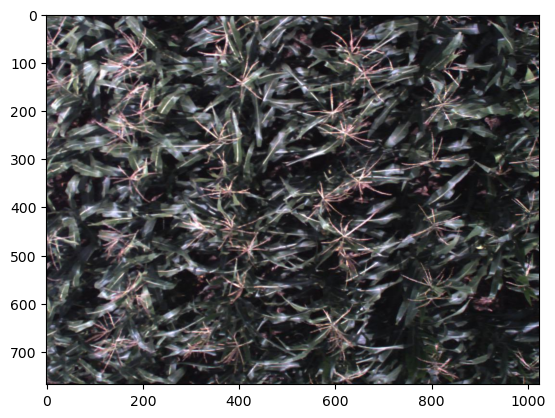

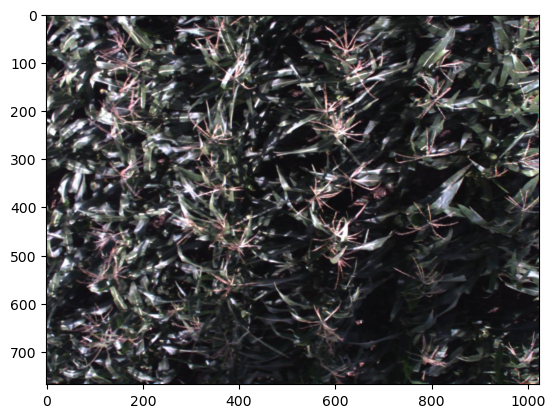

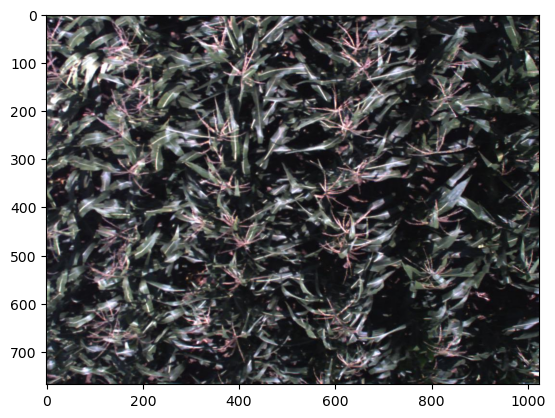

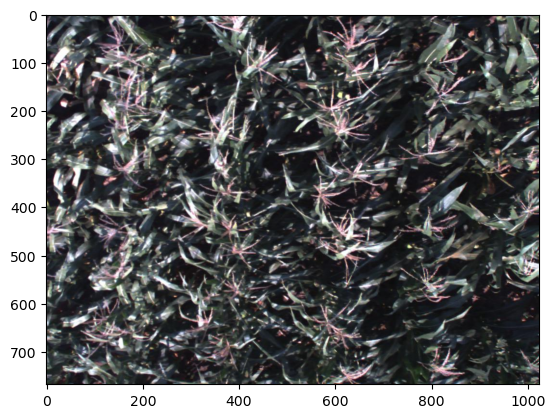

In [39]:
# read the images and plot them
read_images_0102 = read_all_images(all_im_files_0102, block_0102)

In [40]:
for file in read_images_0102:
    print(file.shape)

(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)


In [41]:
# create the subwindow stack
stack_block_0102 = create_and_stack_subwindows(im_height, im_width, stride, kernel_size, n_channels, read_images_0102)

In [42]:
# examine the shape for this
stack_block_0102.shape

(3072, 13, 100, 100, 3)

In [43]:
# Block 0203

In [44]:
# get all image files
all_im_files_0203, mean_0203 =  chose_xml_and_jpeg(block_0203)

In [46]:
# all_im_files_0203, mean_0203

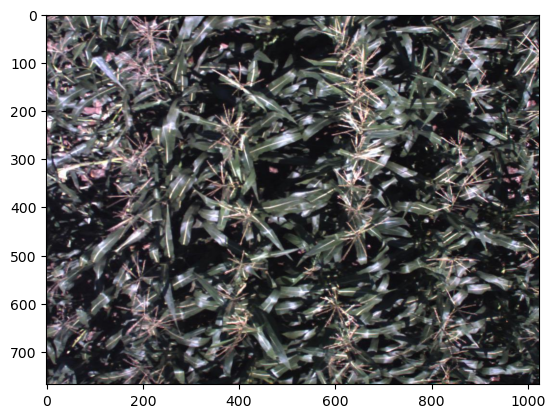

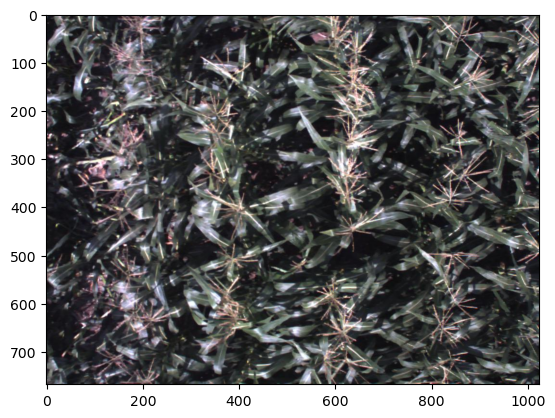

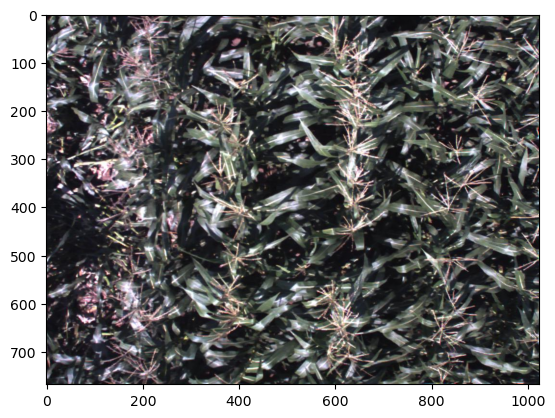

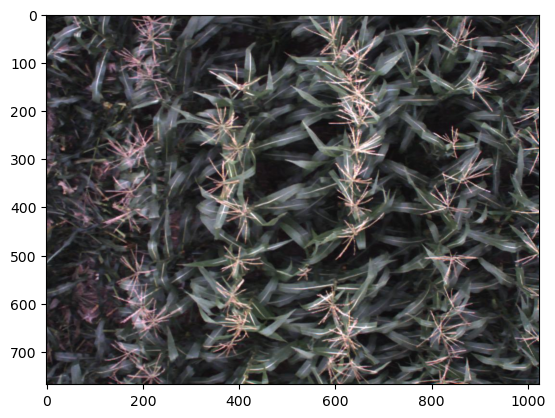

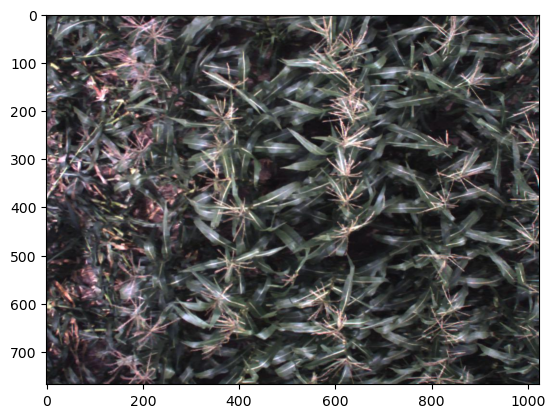

...

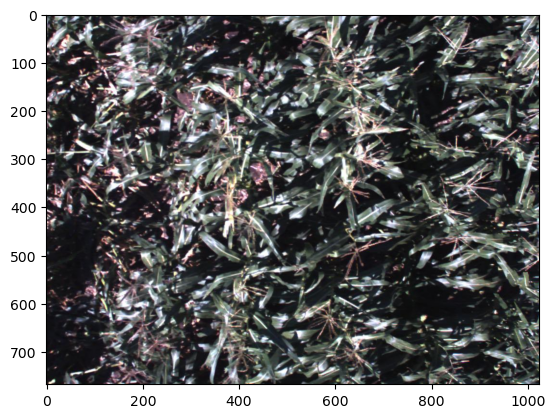

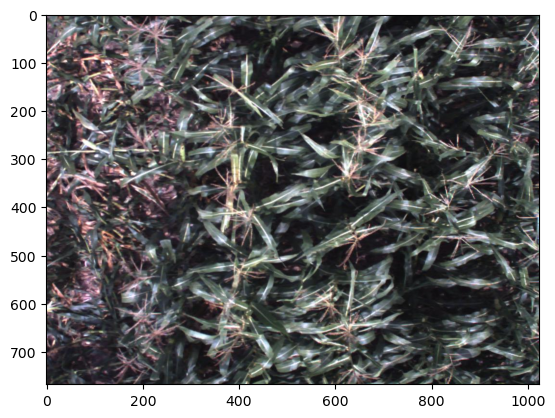

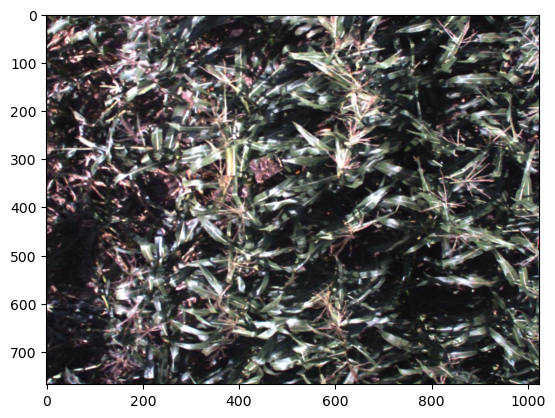

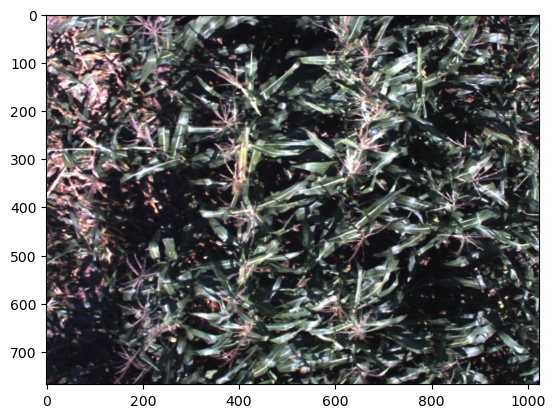

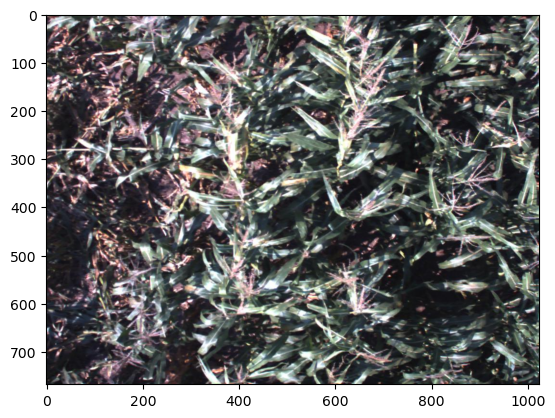

In [47]:
# read the images and plot them
read_images_0203 = read_all_images(all_im_files_0203, block_0203)

In [48]:
for file in read_images_0203:
    print(file.shape)

(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)


In [49]:
# create the subwindow stack
stack_block_0203 = create_and_stack_subwindows(im_height, im_width, stride, kernel_size, n_channels, read_images_0203)

CPU times: user 1min 6s, sys: 4.97 s, total: 1min 11s
Wall time: 1min 12s


In [50]:
# examine the shape for this
stack_block_0203.shape

(3072, 13, 100, 100, 3)

In [51]:
# Block 0301

In [52]:
# get all image files
all_im_files_0301, mean_0301 =  chose_xml_and_jpeg(block_0301)

In [55]:
# all_im_files_0301, mean_0301

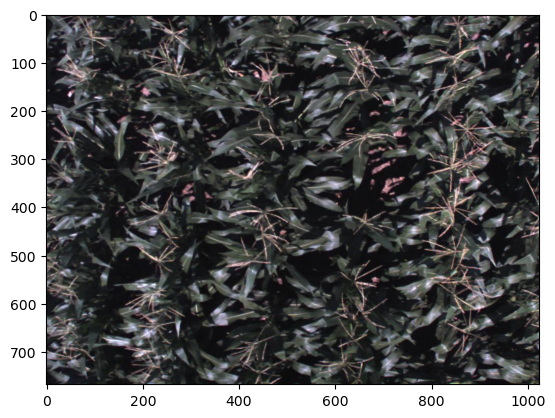

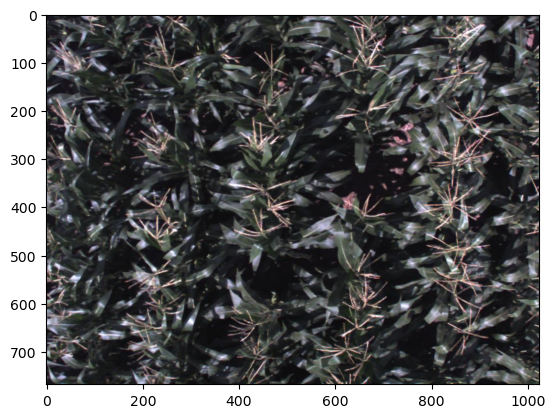

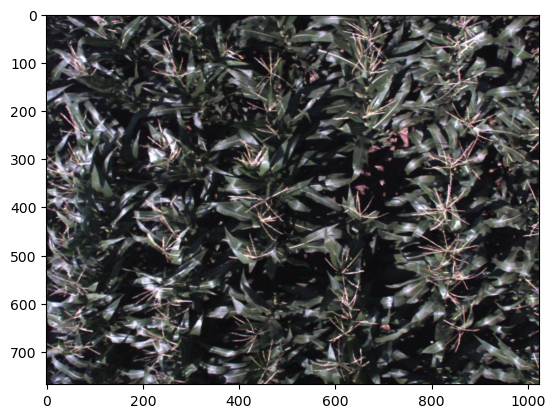

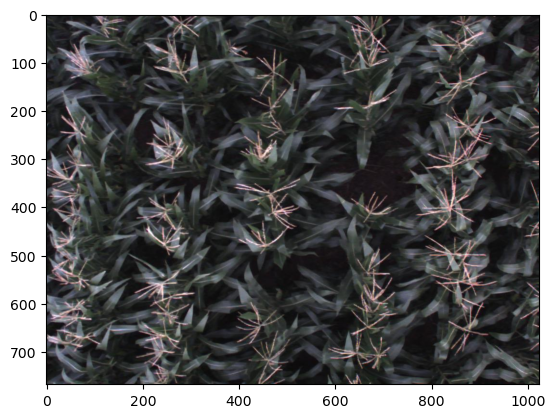

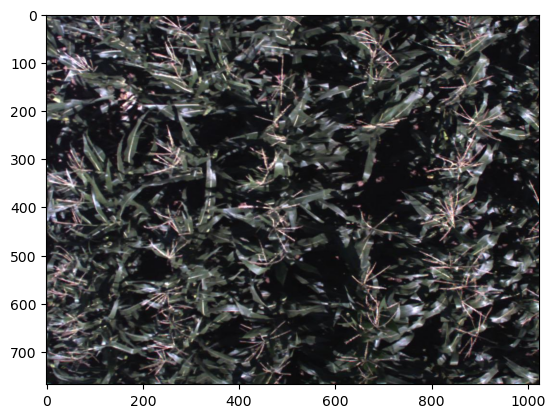

...

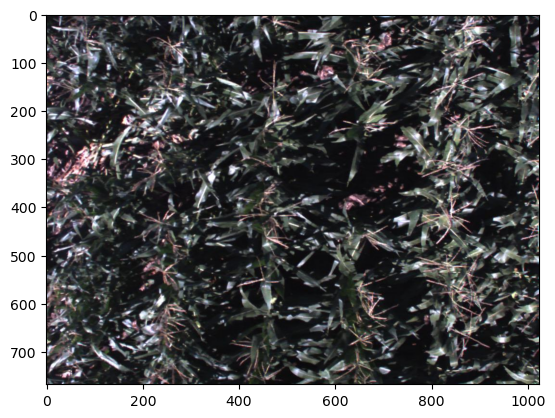

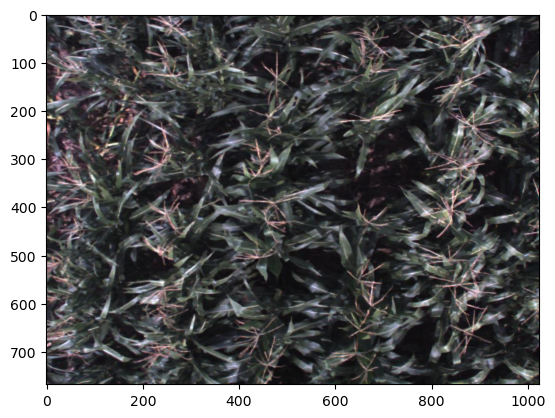

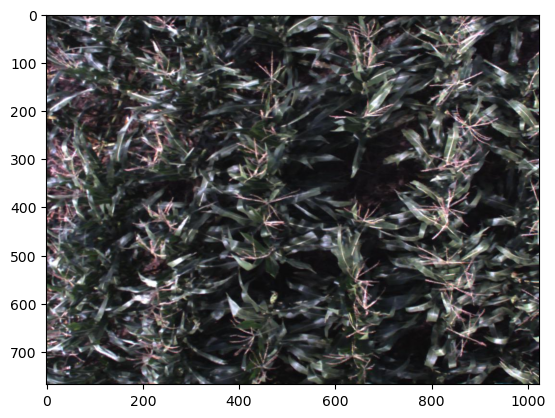

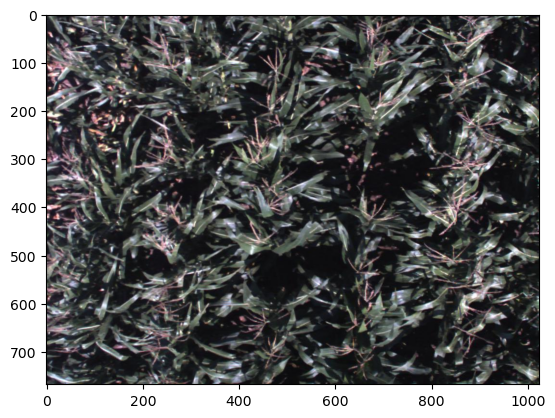

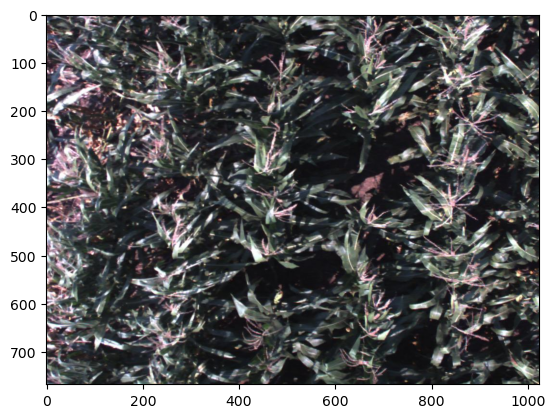

In [56]:
# read the images and plot them
read_images_0301 = read_all_images(all_im_files_0301, block_0301)

In [58]:
# for file in read_images_0301:
#     print(file.shape)

In [ ]:
# create the subwindow stack
stack_block_0301 = create_and_stack_subwindows(im_height, im_width, stride, kernel_size, n_channels, read_images_0301)

In [ ]:
# examine the shape for this
stack_block_0301.shape

In [ ]:
# stack all train data together?
all_stacked_train_data = [stack_block_0101, stack_block_0102, stack_block_0203, stack_block_0301]

In [ ]:
# how to stack? vertically?

train_stack = np.vstack(all_stacked_train_data)

In [ ]:
train_stack.shape

In [ ]:
# sanity check
print(np.mean(stack_block_0101 == train_stack[:910, :, :, :, :]))
print(np.mean(stack_block_0102 == train_stack[910:910*2, :, :, :, :]))
print(np.mean(stack_block_0203 == train_stack[910*2:910*3, :, :, :, :]))
print(np.mean(stack_block_0301 == train_stack[910*3:910*4, :, :, :, :]))

In [ ]:
# save this stack for the use in training the model?
np.save("data/train_input_sub_images/all_train_data.npy", train_stack)

In [ ]:
# # load and verify they are the same - sanity check
# load_npy_train = np.load("data/train_input_sub_images/all_train_data.npy")

In [ ]:
# np.mean(load_npy_train == train_stack)

In [ ]:
# Let's also save the valdiation data

# block 0204

In [ ]:
# get all image files
all_im_files_0204, mean_0204 =  chose_xml_and_jpeg(block_0204)

In [ ]:
# all_im_files_0204, mean_0204

In [ ]:
# read the images and plot them
read_images_0204 = read_all_images(all_im_files_0204, block_0204)

In [ ]:
# for file in read_images_0204:
#     print(file.shape)

In [ ]:
# create the subwindow stack
stack_block_0204 = create_and_stack_subwindows(im_height, im_width, stride, kernel_size, n_channels, read_images_0204)

In [ ]:
# examine the shape for this
stack_block_0204.shape

In [ ]:
# save the validation data

In [ ]:
np.save("data/valid_input_sub_images/all_valid_data.npy", stack_block_0204)

In [ ]:
# sanity check
load_valid = np.load("data/valid_input_sub_images/all_valid_data.npy")

In [ ]:
np.mean(stack_block_0204 == load_valid)

In [1]:
# Okay, getting so many memory errors, let's move forward with a py script? It will be easier to handle

In [1]:
import numpy as np

In [2]:
load_npy_train = np.load("data/train_input_sub_images/all_train_data.npy")

np.mean(load_npy_train)

0.26257495091494065

In [3]:
load_npy_train.shape

(12288, 13, 100, 100, 3)

In [4]:
load_valid = np.load("data/valid_input_sub_images/all_valid_data.npy")

In [5]:
np.mean(load_valid)

0.2595483698416767

In [6]:
load_valid.shape

(3072, 13, 100, 100, 3)

In [8]:
3072*4

12288